## **Playing with Image Pixels**

In [2]:
from PIL import Image
import cv2
import numpy as np
import matplotlib.pyplot as plt

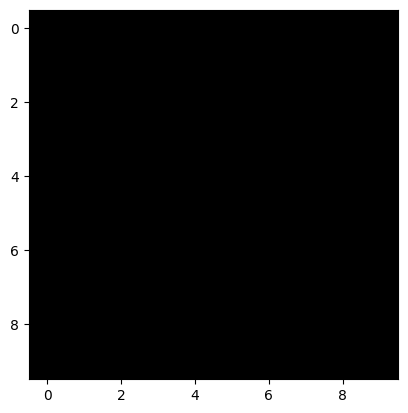

In [3]:
image = np.zeros((10, 10), dtype=int)

plt.imshow(image, cmap="gray")
plt.show()

[[255   0   0   0   0   0   0   0   0 255]
 [  0 255   0   0   0   0   0   0 255   0]
 [  0   0 255   0   0   0   0 255   0   0]
 [  0   0   0 255   0   0 255   0   0   0]
 [  0   0   0   0 255 255   0   0   0   0]
 [  0   0   0   0 255 255   0   0   0   0]
 [  0   0   0 255   0   0 255   0   0   0]
 [  0   0 255   0   0   0   0 255   0   0]
 [  0 255   0   0   0   0   0   0 255   0]
 [255   0   0   0   0   0   0   0   0 255]]


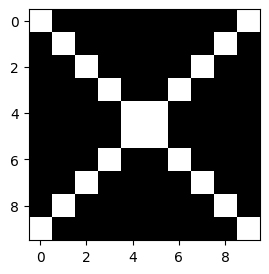

In [4]:
for i in range(10):
    image[i, i] = 255
    image[i, 10 - i - 1] = 255
print(image)
plt.figure(figsize=(3, 3))
plt.imshow(image, cmap="gray")

*Let's try to make Minecraft's Creeper Face*

In [41]:
def save_pixel_image(image, name, scale_factor = 50):
    # saving the creeper image

    pil_image = Image.fromarray(image)

    scaled_image = pil_image.resize(
        (pil_image.width * scale_factor, pil_image.height * scale_factor),
        Image.NEAREST
    )

    scaled_image.save(f"images/saved/{name}.png")

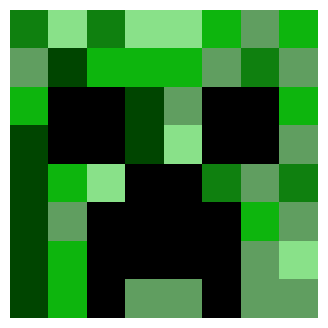

In [43]:
import random

creeper = np.zeros((8, 8, 3), dtype=np.uint8)

black = (0, 0, 0)
lightest_green = (137,225,137)
medium_green = (15,128,15)
base_green = (13,181,13)
light_green = (96,158,96)
dark_green = (0,69,0)

# skin
colors = [lightest_green, medium_green, base_green, light_green, dark_green]
for i in range(8):
    for j in range(8):
        creeper[i, j] = random.choice(colors)

# eyes
creeper[2:4, 1:3] = black
creeper[2:4, 5:7] = black

# nose
creeper[4:5, 3:5] = black

# mouth
creeper[5:7, 2:6] = black
creeper[7, 2] = black
creeper[7, 5] = black

fig = plt.figure(frameon=False)  # no frame
plt.imshow(creeper, interpolation='nearest')  # sharp pixels
plt.axis('off')  # remove axes
fig.set_size_inches(4, 4)

plt.show()

# uncomment below line to save creeper image
# save_pixel_image(creeper, "creeper")

### **Drawing on Image**

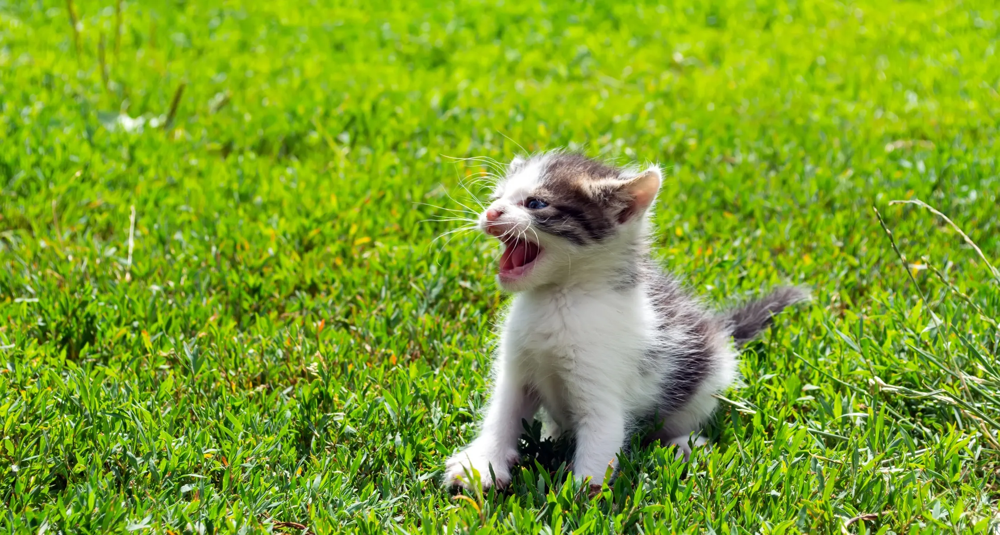

In [7]:
from PIL import ImageDraw

kitten = Image.open("images/kitten.png")
kitten

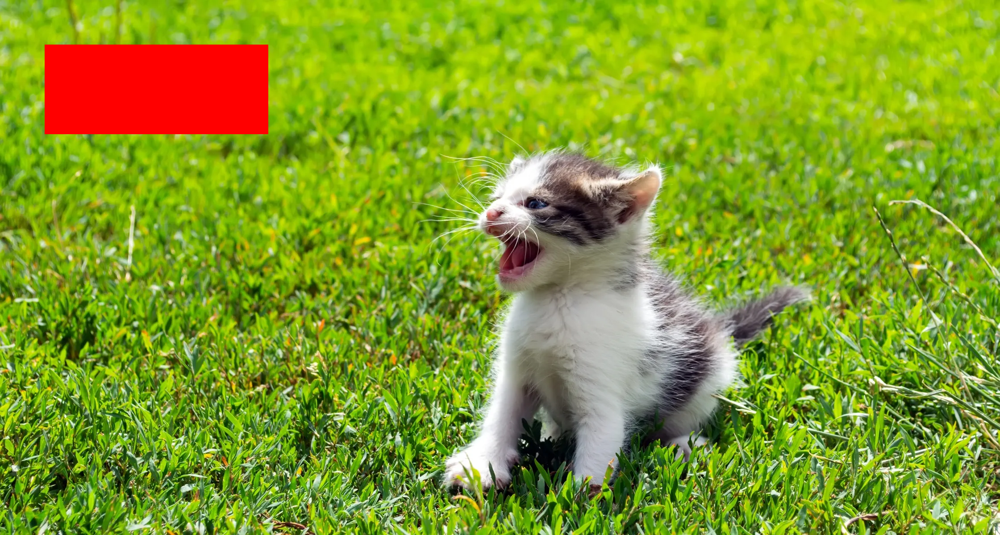

In [8]:
# kitten_fn is an ImageDraw object with drawing functionalities
kitten_draw = kitten.copy()
kitten_fn = ImageDraw.Draw(im=kitten_draw)

shape = [100, 100, 600, 300]
kitten_fn.rectangle(xy=shape, fill="red")
kitten_draw

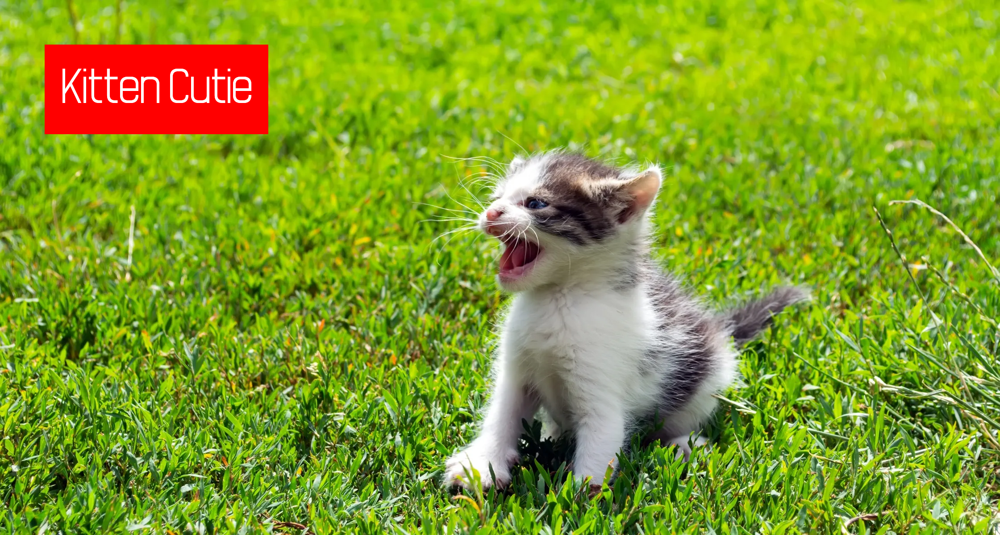

In [40]:
from PIL import ImageFont

fnt = ImageFont.truetype("assets/professional-font.ttf", 120)
kitten_fn.text(xy=(140, 130), text="Kitten Cutie", font=fnt, fill=(255, 255, 255))

kitten_draw.save('images/saved/kitten_draw.png')
kitten_draw

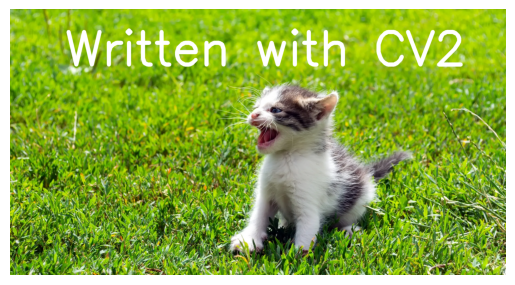

In [39]:
kitten = cv2.imread('images/kitten.png')
kitten = cv2.cvtColor(kitten, cv2.COLOR_BGR2RGB)

cv2.putText(
    img=kitten,
    text="Written with CV2",
    org=(250, 250),
    color=(255, 255, 255),
    fontFace=cv2.FONT_HERSHEY_SIMPLEX,
    fontScale=7,
    thickness=18
)

plt.axis("off")
plt.imshow(kitten)

### **Superimposing Images**

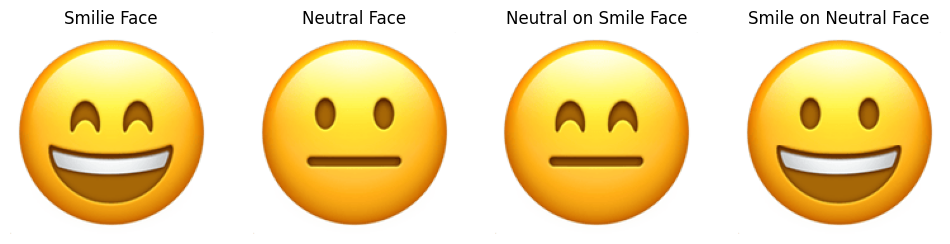

In [11]:
neutral_face = Image.open('images/emojis/neutral.png').convert("RGBA")
smile_face = Image.open('images/emojis/smile.png').convert("RGBA")

# Note: both emojis are [160 x 160] in size

neutral_bottom = neutral_face.crop((0, 80, 160, 160))

# paste using the alpha channel as mask
edited_smile_face = smile_face.copy()
edited_smile_face.paste(neutral_bottom, (0, 80), neutral_bottom)

smile_bottom = smile_face.crop((0, 90, 160, 160))

edited_neutral_face = neutral_face.copy()
edited_neutral_face.paste(smile_bottom, (0, 90), smile_bottom)

""" --- --- --- Plotting Code Below --- --- --- ---"""
# plotting images
fig, axes = plt.subplots(1, 4, figsize=(12, 6)) # 1 row and 3 cols

axes[0].imshow(smile_face)
axes[0].set_title("Smilie Face")
axes[0].axis("off")

axes[1].imshow(neutral_face)
axes[1].set_title("Neutral Face")
axes[1].axis("off")

axes[2].imshow(edited_smile_face)
axes[2].set_title("Neutral on Smile Face")
axes[2].axis("off")

axes[3].imshow(edited_neutral_face)
axes[3].set_title("Smile on Neutral Face")
axes[3].axis("off")

plt.show()

#### *Making a generic function that takes makes combinations of emojis entered.*

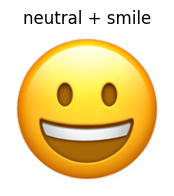

In [12]:
def combine_emojis(emoji1, emoji2, crop_bottom = 0.5, save = False):

    emoji1_img = Image.open(f'images/emojis/{emoji1}.png').convert("RGBA")
    emoji2_img = Image.open(f'images/emojis/{emoji2}.png').convert("RGBA")

    # Note: both emojis are [160 x 160] in size

    crop_height = int(160 * crop_bottom)

    emoji2_bottom = emoji2_img.crop((0, 160 - crop_height, 160, 160))

    # paste using the alpha channel as mask
    edited_img = emoji1_img.copy()
    edited_img.paste(emoji2_bottom, (0, 160 - crop_height), emoji2_bottom)

    # plotting edited emoji
    plt.figure(figsize=(2, 2))
    plt.imshow(edited_img)
    plt.title(f'{emoji1} + {emoji2}')
    plt.axis("off")

    plt.show()

    if (save):
        edited_img.save(f'images/emojis/edited/{emoji1}+{emoji2}.png')

combine_emojis('neutral', 'smile')

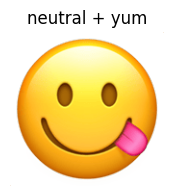

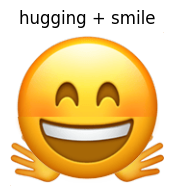

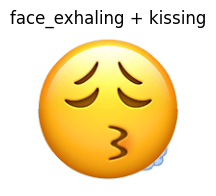

In [13]:
combine_emojis('neutral', 'yum')
# you can put `save=True` to save your desired combination
# combine_emojis('neutral', 'yum', save=True)

combine_emojis('hugging', 'smile', 0.45)
combine_emojis('face_exhaling', 'kissing')

In [14]:
# haha car go vroom vroom boom boom brrr...